In [1]:
import pandas as pd
import numpy as np
import random

import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta

pd.set_option('display.max_columns', None)
pd.options.display.float_format = '{:,.2f}'.format

from IPython.core import display as ICD

from sklearn import datasets

# Import data

In [2]:
import sklearn.datasets

data = sklearn.datasets.fetch_california_housing(return_X_y=False, as_frame=True)
df = data["frame"]

def random_date(start, end, random_amount):
    delta = (end - start).days
    return [start + timedelta(days=random.randrange(delta)) for i in range(random_amount)]

d1 = datetime.strptime('2022-01-01', '%Y-%m-%d')
d2 = datetime.strptime('2022-03-31', '%Y-%m-%d')

df['datetime'] = random_date(d1,d2,df.shape[0])
df['date'] = df['datetime'].apply(lambda x: x.date())
df = df.reindex(columns= ['datetime', 'date'] + list(df.columns[:-2]))
df['direction'] = df['Latitude'].apply(lambda x: 'North' if x >= 36 else 'South')
df['is_expensive'] = df['MedHouseVal'].apply(lambda x: True if x >= 2.5 else False)
df.head()

,datetime,date,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,direction,is_expensive
0,2022-03-03,2022-03-03,8.33,41.00,6.98,1.02,322.00,2.56,37.88,-122.23,4.53,North,True
1,2022-02-18,2022-02-18,8.30,21.00,6.24,0.97,"2,401.00",2.11,37.86,-122.22,3.58,North,True
2,2022-03-09,2022-03-09,7.26,52.00,8.29,1.07,496.00,2.80,37.85,-122.24,3.52,North,True
3,2022-01-08,2022-01-08,5.64,52.00,5.82,1.07,558.00,2.55,37.85,-122.25,3.41,North,True
4,2022-02-14,2022-02-14,3.85,52.00,6.28,1.08,565.00,2.18,37.85,-122.25,3.42,North,True


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   datetime      20640 non-null  datetime64[ns]
 1   date          20640 non-null  object        
 2   MedInc        20640 non-null  float64       
 3   HouseAge      20640 non-null  float64       
 4   AveRooms      20640 non-null  float64       
 5   AveBedrms     20640 non-null  float64       
 6   Population    20640 non-null  float64       
 7   AveOccup      20640 non-null  float64       
 8   Latitude      20640 non-null  float64       
 9   Longitude     20640 non-null  float64       
 10  MedHouseVal   20640 non-null  float64       
 11  direction     20640 non-null  object        
 12  is_expensive  20640 non-null  bool          
dtypes: bool(1), datetime64[ns](1), float64(9), object(2)
memory usage: 1.9+ MB


# Pandas_profiling
- https://pypi.org/project/pandas-profiling/

In [4]:
from pandas_profiling import ProfileReport
# create profile report
profile = ProfileReport(df, title="Pandas Profiling Report")
# save report
profile.to_file("pandas_profiling.html")
# show on jupyter lab
profile.to_widgets()

Describe
- Show duplicate row from iris dataset example


# SweetViz
- https://pypi.org/project/sweetviz/

In [5]:
import sweetviz as sv
analyze_report = sv.analyze(df)
analyze_report.show_html('report.html', open_browser=True)
# analyze_report.show_notebook()


Report report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [6]:
analyze_report_2 = sv.compare_intra(df, df["direction"] == "North", ["North", "South"])
analyze_report_2.show_html('report_2.html', open_browser=True)


Report report_2.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


# AutoViz
- https://github.com/AutoViML/AutoViz

In [7]:
# from autoviz.AutoViz_Class import AutoViz_Class
# AV = AutoViz_Class()
# df_av = AV.AutoViz(filename=""
#                    , dfte=df
#                    # , depVar='label'
#                    # , verbose=0
#                    # , chart_format="html"
#                    # , save_plot_dir='autoviz.html'
#                       )

Alert! from version 0.1.39, fter importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
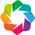

Shape of your Data Set loaded: (20640, 13)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    13 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Number of All Scatter Plots = 45
Could not draw Violin Plot
Could not draw Date Vars
Time to run AutoViz = 15 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


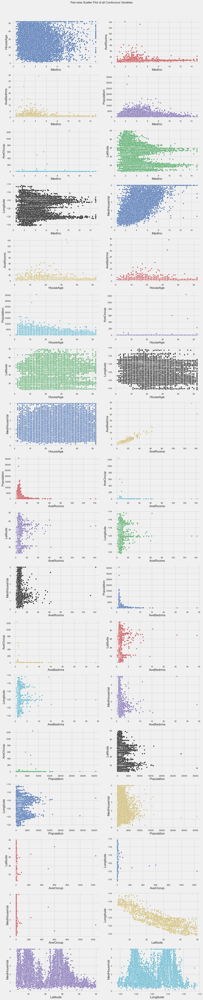

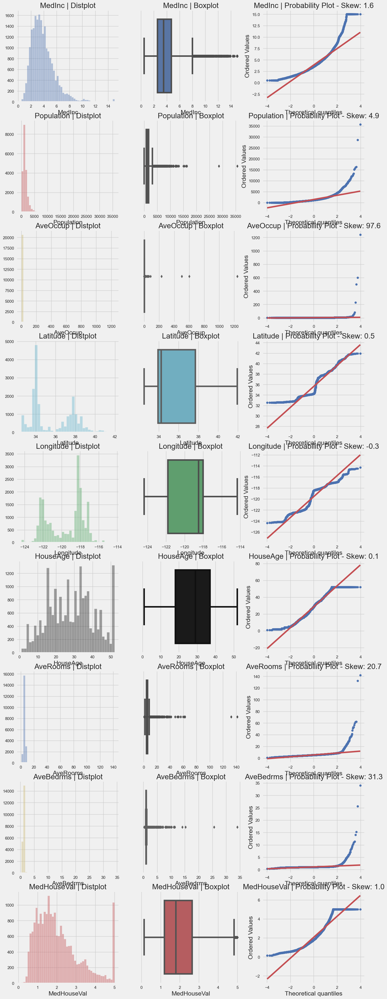

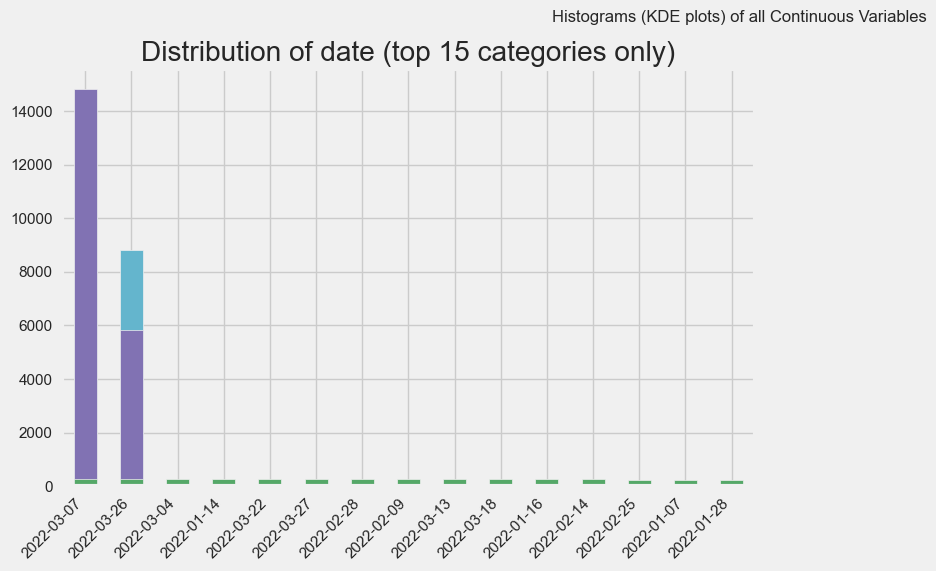

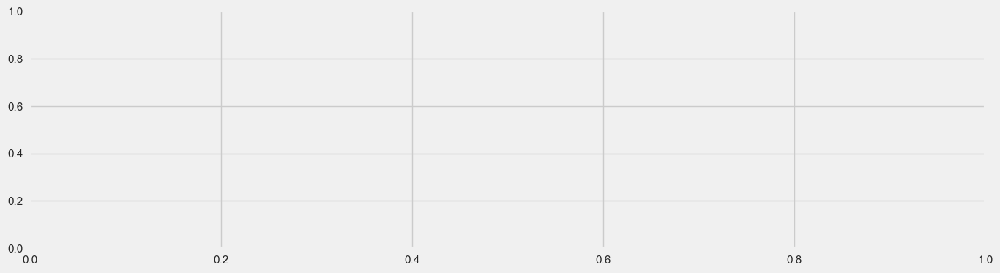

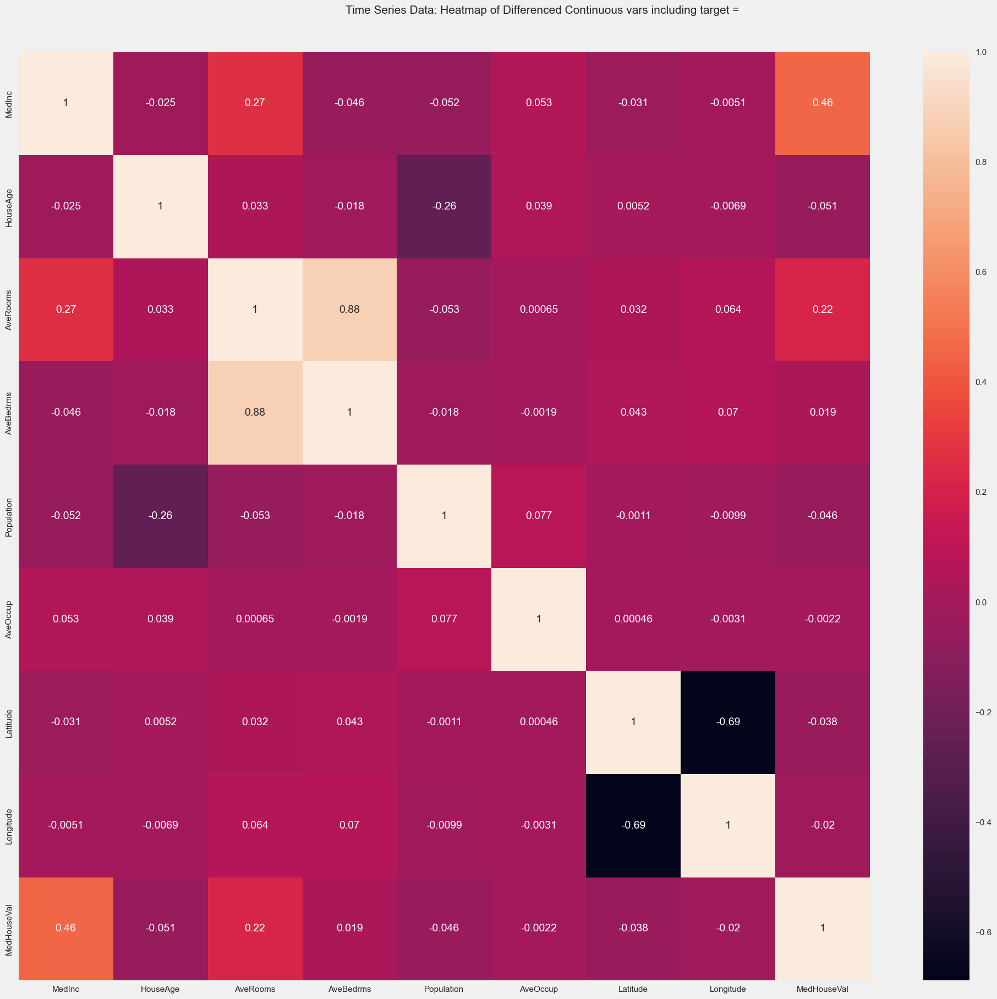

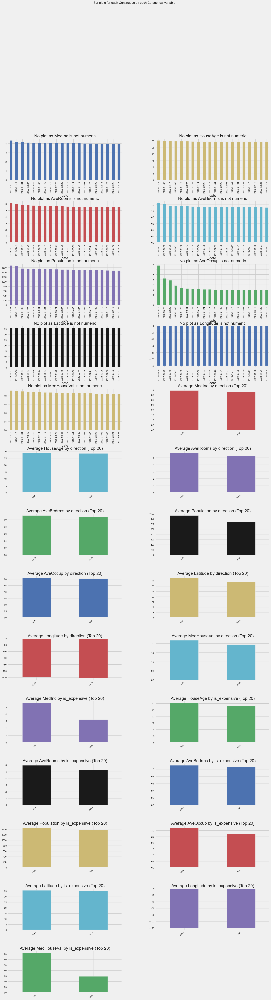

In [8]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()
df_av = AV.AutoViz(filename=""
                    , dfte=df
                      )

In [9]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()
df_av = AV.AutoViz(filename=""
                   , dfte=df
                   , chart_format='bokeh'
                      )

Shape of your Data Set loaded: (20640, 13)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    13 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
No scatter plots with depVar when no depVar is given.


Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['MedInc', 'HouseAge', ...], value='MedInc')
        [1] Select(name='Y-Axis', options=['MedInc', 'HouseAge', ...], value='HouseAge')
        [2] Select(name='Color', options=['None'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['MedInc', 'Population', ...], value='MedInc', width=250)
            [1] VSpacer()

FloatingPointError: underflow encountered in true_divide

HoloViews(Violin)

HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['datetime'], value='datetime')
        [1] Select(name='Y-Axis', options=['MedInc', 'HouseAge', ...], value='MedInc')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['date', 'direction', ...], value='date')
        [1] Select(name='Y-Axis', options=['MedInc', 'HouseAge', ...], value='MedInc')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 7


# Dtale
- https://pypi.org/project/dtale/

In [4]:
import dtale
d = dtale.show(df)
d.open_browser() # <-- To show in new browser (Suggested)
# dtale.show(df) <-- This for showing in jupyter

Exception occurred while processing request: It appears there is duplicates in your index, please specify an aggregation!
Traceback (most recent call last):
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\views.py", line 121, in _handle_exceptions
    return func(*args, **kwargs)
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\views.py", line 3732, in get_timeseries_analysis
    data = ts_rpt.run()
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\timeseries_analysis.py", line 48, in run
    return self.report.run(data)
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\timeseries_analysis.py", line 93, in run
    df = build_data(data, self.cfg)
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\timeseries_analysis.py", line 18, in build_data
    raise ValueError(
ValueError: It appears there is duplicates in your index, please specify an aggregation!


2022-06-12 21:45:15,124 - ERROR    - Exception occurred while processing request: It appears there is duplicates in your index, please specify an aggregation!
Traceback (most recent call last):
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\views.py", line 121, in _handle_exceptions
    return func(*args, **kwargs)
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\views.py", line 3732, in get_timeseries_analysis
    data = ts_rpt.run()
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\timeseries_analysis.py", line 48, in run
    return self.report.run(data)
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\timeseries_analysis.py", line 93, in run
    df = build_data(data, self.cfg)
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\timeseries_analysis.py", line 18, in build_data
    raise ValueError(
ValueError: It appears there is duplicates in your index, please specify an aggregation!


Exception occurred while processing request: data type 'date' not understood
Traceback (most recent call last):
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\views.py", line 121, in _handle_exceptions
    return func(*args, **kwargs)
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\views.py", line 2073, in describe
    uniq_grp["value"] = uniq_grp["value"].astype(uniq_type)
  File "C:\Users\freshket\anaconda3\lib\site-packages\pandas\core\generic.py", line 5546, in astype
    new_data = self._mgr.astype(dtype=dtype, copy=copy, errors=errors,)
  File "C:\Users\freshket\anaconda3\lib\site-packages\pandas\core\internals\managers.py", line 595, in astype
    return self.apply("astype", dtype=dtype, copy=copy, errors=errors)
  File "C:\Users\freshket\anaconda3\lib\site-packages\pandas\core\internals\managers.py", line 406, in apply
    applied = getattr(b, f)(**kwargs)
  File "C:\Users\freshket\anaconda3\lib\site-packages\pandas\core\internals\blocks.py", line 548, 

2022-06-12 22:17:01,558 - ERROR    - Exception occurred while processing request: data type 'date' not understood
Traceback (most recent call last):
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\views.py", line 121, in _handle_exceptions
    return func(*args, **kwargs)
  File "C:\Users\freshket\anaconda3\lib\site-packages\dtale\views.py", line 2073, in describe
    uniq_grp["value"] = uniq_grp["value"].astype(uniq_type)
  File "C:\Users\freshket\anaconda3\lib\site-packages\pandas\core\generic.py", line 5546, in astype
    new_data = self._mgr.astype(dtype=dtype, copy=copy, errors=errors,)
  File "C:\Users\freshket\anaconda3\lib\site-packages\pandas\core\internals\managers.py", line 595, in astype
    return self.apply("astype", dtype=dtype, copy=copy, errors=errors)
  File "C:\Users\freshket\anaconda3\lib\site-packages\pandas\core\internals\managers.py", line 406, in apply
    applied = getattr(b, f)(**kwargs)
  File "C:\Users\freshket\anaconda3\lib\site-packages\pandas\

In [11]:
a= d.data.copy()
a['direction'].unique()

array(['North', 'South'], dtype=object)

# Pivottablejs

# Pandasgui